# Surprise Housing Assignment

### Problem Statement

A US-based housing company named Surprise Housing has decided to enter the Australian market. The company uses data analytics to purchase houses at a price below their actual values and flip them on at a higher price. For the same purpose, the company has collected a data set from the sale of houses in Australia. The data is provided in the CSV file below.

The company is looking at prospective properties to buy to enter the market. You are required to build a regression model using regularisation in order to predict the actual value of the prospective properties and decide whether to invest in them or not.

The company wants to know:
- Which variables are significant in predicting the price of a house, and
- How well those variables describe the price of a house.

#### Business Goal:

You are required to model the price of houses with the available independent variables. This model will then be used by the management to understand how exactly the prices vary with the variables. They can accordingly manipulate the strategy of the firm and concentrate on areas that will yield high returns. Further, the model will be a good way for management to understand the pricing dynamics of a new market.

In [1]:
# Importing Libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import linear_model, metrics
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score

import os

# hide warnings
import warnings
warnings.filterwarnings('ignore')

pd.options.display.max_columns = None
pd.options.display.max_rows = None

In [2]:
# Importing Dataset

housing = pd.read_csv('train.csv')

housing.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [3]:
#Checking the shape of the dataset

print(f'The dataset contains {housing.shape[0]} rows and {housing.shape[1]} columns')

The dataset contains 1460 rows and 81 columns


In [4]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [5]:
# Checking for Null values

#creating a dataframe where the null counts are stored and new integer index is created
null_count = pd.DataFrame(housing.isnull().sum()).reset_index() 

#renaming columns
null_count.rename(columns= {'index': 'Features', 0: 'Null_Count'}, inplace= True) 

null_count

,Features,Null_Count
0,Id,0
1,MSSubClass,0
2,MSZoning,0
3,LotFrontage,259
4,LotArea,0
5,Street,0
6,Alley,1369
7,LotShape,0
8,LandContour,0
9,Utilities,0


In [6]:
#Creating a percentage of null values in each columns
null_count['%_Null_Values'] = (null_count['Null_Count']/housing.shape[0])*100 

null_count.sort_values(by = '%_Null_Values', ascending = False) #sorting by descending order

,Features,Null_Count,%_Null_Values
72,PoolQC,1453,99.520548
74,MiscFeature,1406,96.301370
6,Alley,1369,93.767123
73,Fence,1179,80.753425
57,FireplaceQu,690,47.260274
3,LotFrontage,259,17.739726
59,GarageYrBlt,81,5.547945
64,GarageCond,81,5.547945
58,GarageType,81,5.547945
60,GarageFinish,81,5.547945


In [7]:
#Creating a list of columns with more than 50% null values so that we can drop them

drop_cols = null_count[null_count['%_Null_Values'] >= 50]['Features'].to_list()

len(drop_cols)

4

In [8]:
#dropping columns

housing_2 = housing.drop(labels = drop_cols, axis = 1)

#Checking the shape of the dataset

print(f'The dataset contains {housing_2.shape[0]} rows and {housing_2.shape[1]} columns')

The dataset contains 1460 rows and 77 columns


In [9]:
housing_2.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [10]:
# Seperating numerical and catagorical features for analysis
numeric = housing_2.select_dtypes(include = ['int64', 'float64'])
catagorical = housing_2.select_dtypes(include = ['object'])

In [11]:
#list of numerical features
numeric.columns

Index(['Id', 'MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
       'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')

### Analyzing Numerical Data

**Checking for Outliers** <br>
Checking percentage of outliers for all the numerical columns.

In [12]:
outlier_percentage = {}

for feature in numeric.columns:
    iqr = numeric[feature].quantile(.75) - numeric[feature].quantile(.25)
    outlier_count = numeric[(numeric[feature] > (numeric[feature].quantile(.75)+1.5*iqr)) | 
                            (numeric[feature] > (numeric[feature].quantile(.25)-1.5*iqr))].shape[0]
    outlier_percentage[feature] = round(outlier_count/numeric.shape[0]*100, 2)

outliers = pd.DataFrame({'Features': list(outlier_percentage.keys()), 'Percentage': list(outlier_percentage.values())})
outliers.sort_values(by = "Percentage", ascending = False)

,Features,Percentage
0,Id,100.00
14,2ndFlrSF,100.00
36,YrSold,100.00
35,MoSold,100.00
29,OpenPorchSF,100.00
28,WoodDeckSF,100.00
27,GarageArea,100.00
26,GarageCars,100.00
24,Fireplaces,100.00
20,HalfBath,100.00


**Comment:**
- Most of tne numerical features have outliers. 
- Dropping outliers will cause loss of information.
- Therefore we will be reassigning values minimum and maximum values to those rows outside the range of **[ 25th Percentile - 1.5*IQR, 75th Percentile + 1.5*IQR ]**
- IQR or Inter Quartile Range is the difference between 75th and 25th percentile.
- We will be excluding the the target variable 'SalesPrice' in this.

In [13]:
for feature, percentage in outlier_percentage.items():
    if feature!= 'SalePrice':
        iqr = housing_2[feature].quantile(0.75) - housing_2[feature].quantile(0.25)
        max_val = housing_2[feature].quantile(0.75)+1.5*iqr
        mix_val = housing_2[feature].quantile(0.25)-1.5*iqr
        housing_2[feature][housing_2[feature] > max_val] = max_val
        housing_2[feature][housing_2[feature] < mix_val] = mix_val

In [14]:
#Checking the dataset after reassigning minimum and maximum values

housing_2.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.0,1460.000000,1460.000000,1460.000000,1460.000000,1460.0,1460.000000,1460.000000,1460.0,1460.000000,1460.000000,1460.000000,1460.0,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.0,1460.0,1460.0,1460.0,1460.0,1460.000000,1460.000000,1460.000000
mean,730.500000,55.085616,69.134888,9647.388014,6.100685,5.543493,1971.299315,1984.865753,90.192149,439.997517,0.0,563.777740,1050.254795,1157.018151,346.789041,0.0,1503.735873,0.425000,0.0,1.565068,0.382877,2.851712,1.0,6.487671,0.611301,1978.506164,1.765411,470.670719,91.806849,42.603425,0.0,0.0,0.0,0.0,0.0,6.321918,2007.815753,180921.195890
std,421.610009,37.508183,19.662022,3594.356399,1.378430,0.963696,30.108397,20.645407,134.925253,433.219435,0.0,431.710214,397.937878,362.583002,435.791621,0.0,481.375641,0.517373,0.0,0.550916,0.502885,0.759516,0.0,1.541916,0.638959,24.689725,0.742753,207.105729,116.658120,52.501584,0.0,0.0,0.0,0.0,0.0,2.703626,1.328095,79442.502883
min,1.000000,20.000000,27.500000,1481.500000,2.000000,3.500000,1885.000000,1950.000000,0.000000,0.000000,0.0,0.000000,42.000000,334.000000,0.000000,0.0,334.000000,0.000000,0.0,0.000000,0.000000,0.500000,1.0,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.0,223.000000,795.750000,882.000000,0.000000,0.0,1129.500000,0.000000,0.0,1.000000,0.000000,2.000000,1.0,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.0,477.500000,991.500000,1087.000000,0.000000,0.0,1464.000000,0.000000,0.0,2.000000,0.000000,3.000000,1.0,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.0,0.0,0.0,0.0,0.0,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.0,808.000000,1298.250000,1391.250000,728.000000,0.0,1776.750000,1.000000,0.0,2.000000,1.000000,3.000000,1.0,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.0,0.0,0.0,0.0,0.0,8.000000,2009.000000,214000.000000
max,1460.000000,145.000000,111.500000,17673.500000,10.000000,7.500000,2010.000000,2010.000000,415.000000,1780.625000,0.0,1685.500000,2052.000000,2155.125000,1820.000000,0.0,2747.625000,2.500000,0.0,3.000000,2.000000,4.500000,1.0,10.000000,2.500000,2010.000000,3.500000,938.250000,420.000000,170.000000,0.0,0.0,0.0,0.0,0.0,12.000000,2010.000000,755000.000000


**Checking for Correlation of the numerical features**

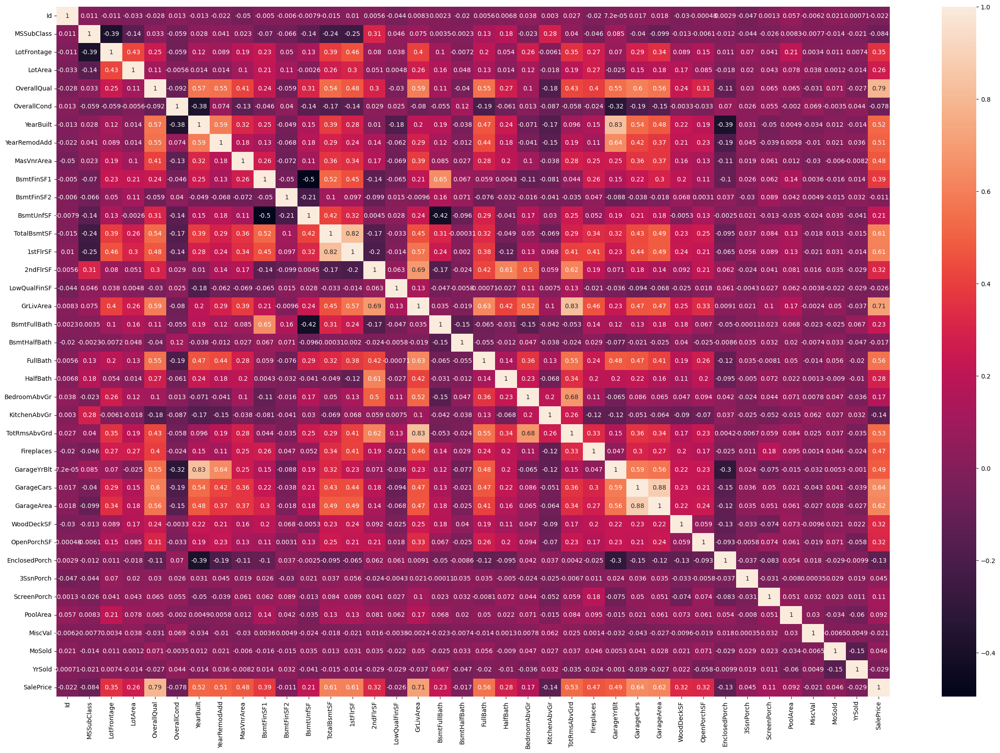

In [15]:
plt.figure(figsize = (30, 20))
sns.heatmap(numeric.corr(), annot = True)
plt.show()

***Comments:***
- From the heatmap we can see that some of the features have high correlation with each other.
- GarageCars and GarageArea have high correlation of 0.88. Since larger the garage area higher will be the number of cars that can be placed in it.
- GarageYrBlt and YearBuilt have high correlation of 0.83. Since a lot of garages would have been built when the house was being built.
- TotRmsAbvGrd and GrLivArea have high correlation of 0.83. Higher the area above ground then higher will be the number of rooms.

**Analyzing Numerical Features**

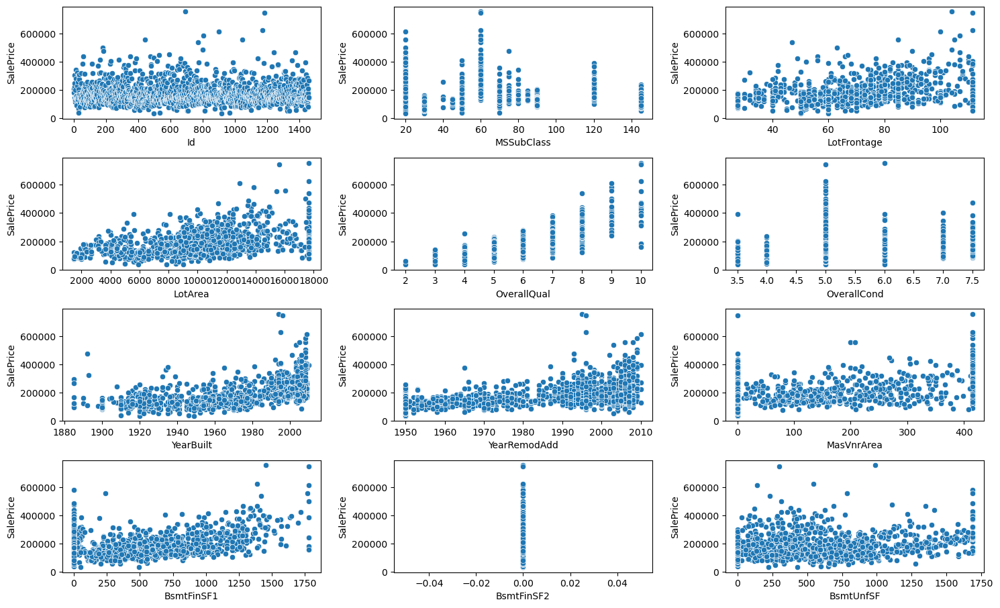

In [16]:
fig = plt.subplots(figsize = (15, 20))
for i, feature in enumerate(numeric.columns[0:12]):
    plt.subplot(9, 3, i+1)
    plt.subplots_adjust(hspace = 2.0)
    sns.scatterplot(x = housing_2[feature], y = housing_2['SalePrice'])
    plt.tight_layout()

***Comments:***
- Id is the just an index therefore we can drop this variable.
- Variables like: MSSubClass, OverallQual, OverallCond are discrete variables.
- YearBuilt and YearRemodAdd can also be considered as discrete since these are the years on which the houses were built or remodelled.
- LotFrontage, LotArea, MasVnrArea, BsmtFinSF1, BsmtUnfSF have positive correlation with SalePrice.
- BsmtFinSF2 has only single value.

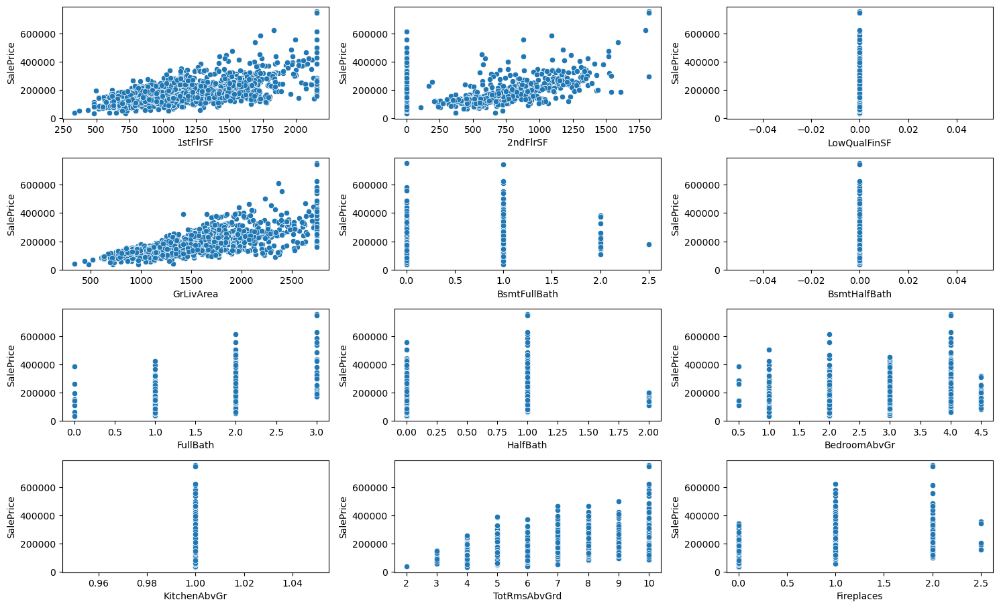

In [17]:
fig = plt.subplots(figsize = (15, 20))
for i, feature in enumerate(numeric.columns[13:25]):
    plt.subplot(9, 3, i+1)
    plt.subplots_adjust(hspace = 2.0)
    sns.scatterplot(x = housing_2[feature], y = housing_2['SalePrice'])
    plt.tight_layout()

***Comments:***
- 1stFlrSF, 2ndFlrSF, GrLivArea have positive correlation with SalesPrice.
- BsmtFullBath, FullBath, HalfBath, BedroomAbvGr, TotRmsAbvGrd, Fireplaces are discrete variables.
- LowQualFinSF, BsmtHalfBath, KitchenAbvGrd have single values.

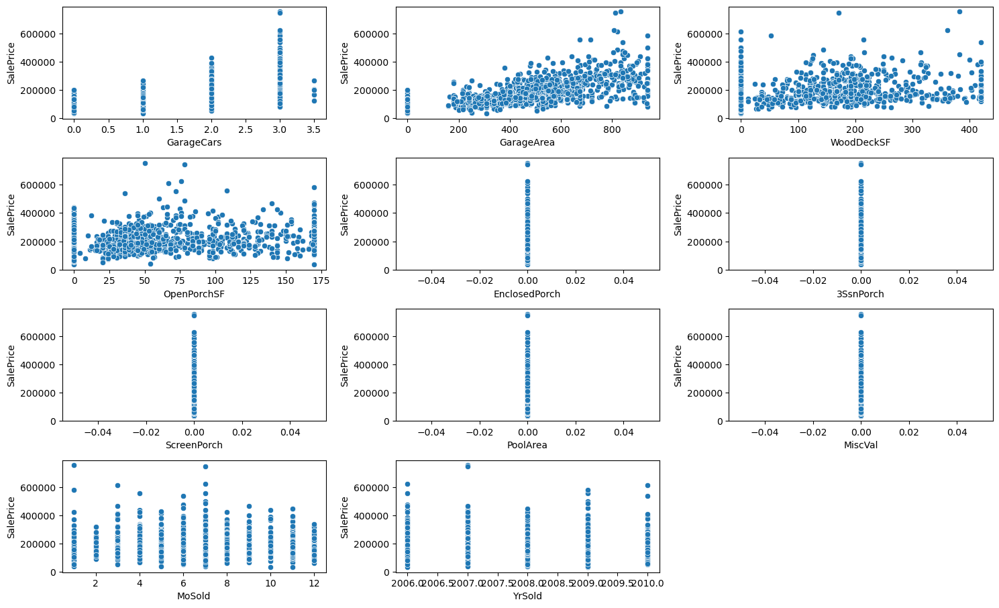

In [18]:
fig = plt.subplots(figsize = (15, 20))
for i, feature in enumerate(numeric.columns[26:37]):
    plt.subplot(9, 3, i+1)
    plt.subplots_adjust(hspace = 2.0)
    sns.scatterplot(x = housing_2[feature], y = housing_2['SalePrice'])
    plt.tight_layout()

***Comments:***
- GarageArea, WoodDeckSF, OpenPorchSF have positive correlation with SalePrice.
- GarageCars is a disrete variable with positive correlation with SalePrice.
- EnclosedPorch, 3SsnPorch, ScreenPorch, PoolArea, MiscVal have single values.
- MoSold and YrSold is the month and year the house was sold.

**Visualizing the Distributions of the continuous numerical features**

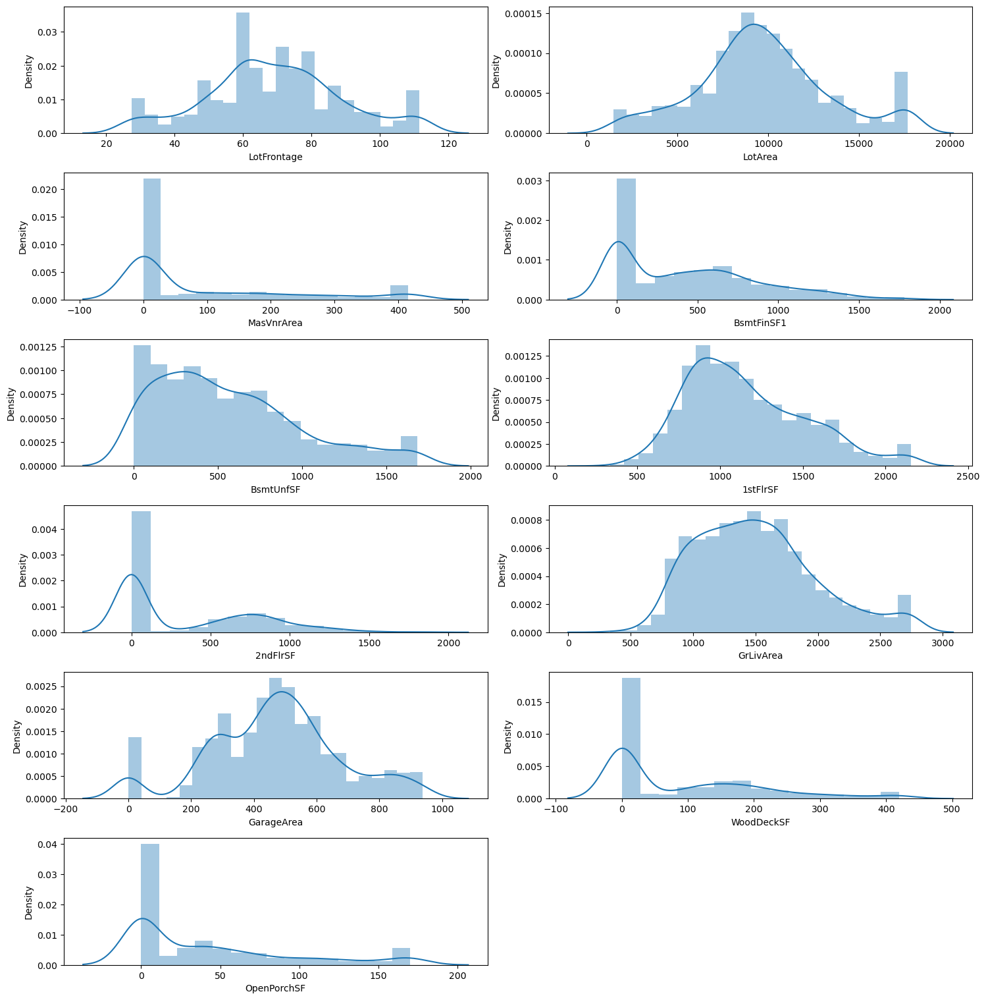

In [19]:
fig = plt.subplots(figsize = (15, 30))
for i, feature in enumerate(['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtUnfSF', '1stFlrSF', '2ndFlrSF', 
                             'GrLivArea', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF']):
    plt.subplot(12, 2, i+1)
    plt.subplots_adjust(hspace = 2.0)
    sns.distplot(housing_2[feature])
    plt.tight_layout()

In [20]:
# Checking descriptive statistics of variables with single values

housing_2[['BsmtFinSF2', 'LowQualFinSF', 'BsmtHalfBath', 'KitchenAbvGr', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 
                    'PoolArea', 'MiscVal']].describe()

,BsmtFinSF2,LowQualFinSF,BsmtHalfBath,KitchenAbvGr,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal
count,1460.0,1460.0,1460.0,1460.0,1460.0,1460.0,1460.0,1460.0,1460.0
mean,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


***Observation:*** <br>

We can see from the descriptive statistics that there is barely any variation in the data for the above variables. Therefore we can conclude that these variables would not contribute much in the prediction of sales price hence we can proceed to drop them from our dataset.

In [21]:
# Dropping Variables with no variation in the data

housing_3 = housing_2.drop(labels = ['Id','BsmtFinSF2', 'LowQualFinSF', 'BsmtHalfBath', 'KitchenAbvGr', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 
                    'PoolArea', 'MiscVal'], axis = 1)

#Checking the shape of the dataset

print(f'The dataset contains {housing_3.shape[0]} rows and {housing_3.shape[1]} columns')

The dataset contains 1460 rows and 67 columns


**Analyzing Numerical Features with discrete values:**

In [22]:
housing_3[['MSSubClass', 'OverallQual', 'OverallCond', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'Fireplaces', 
           'GarageCars', 'TotRmsAbvGrd', 'MoSold', 'YrSold', 'GarageYrBlt', 'YearBuilt', 'YearRemodAdd']]

,MSSubClass,OverallQual,OverallCond,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,Fireplaces,GarageCars,TotRmsAbvGrd,MoSold,YrSold,GarageYrBlt,YearBuilt,YearRemodAdd
0,60,7,5.0,1.0,2,1,3.0,0.0,2.0,8,2,2008,2003.0,2003,2003
1,20,6,7.5,0.0,2,0,3.0,1.0,2.0,6,5,2007,1976.0,1976,1976
2,60,7,5.0,1.0,2,1,3.0,1.0,2.0,6,9,2008,2001.0,2001,2002
3,70,7,5.0,1.0,1,0,3.0,1.0,3.0,7,2,2006,1998.0,1915,1970
4,60,8,5.0,1.0,2,1,4.0,1.0,3.0,9,12,2008,2000.0,2000,2000
5,50,5,5.0,1.0,1,1,1.0,0.0,2.0,5,10,2009,1993.0,1993,1995
6,20,8,5.0,1.0,2,0,3.0,1.0,2.0,7,8,2007,2004.0,2004,2005
7,60,7,6.0,1.0,2,1,3.0,2.0,2.0,7,11,2009,1973.0,1973,1973
8,50,7,5.0,0.0,2,0,2.0,2.0,2.0,8,4,2008,1931.0,1931,1950
9,145,5,6.0,1.0,1,0,2.0,2.0,1.0,5,1,2008,1939.0,1939,1950


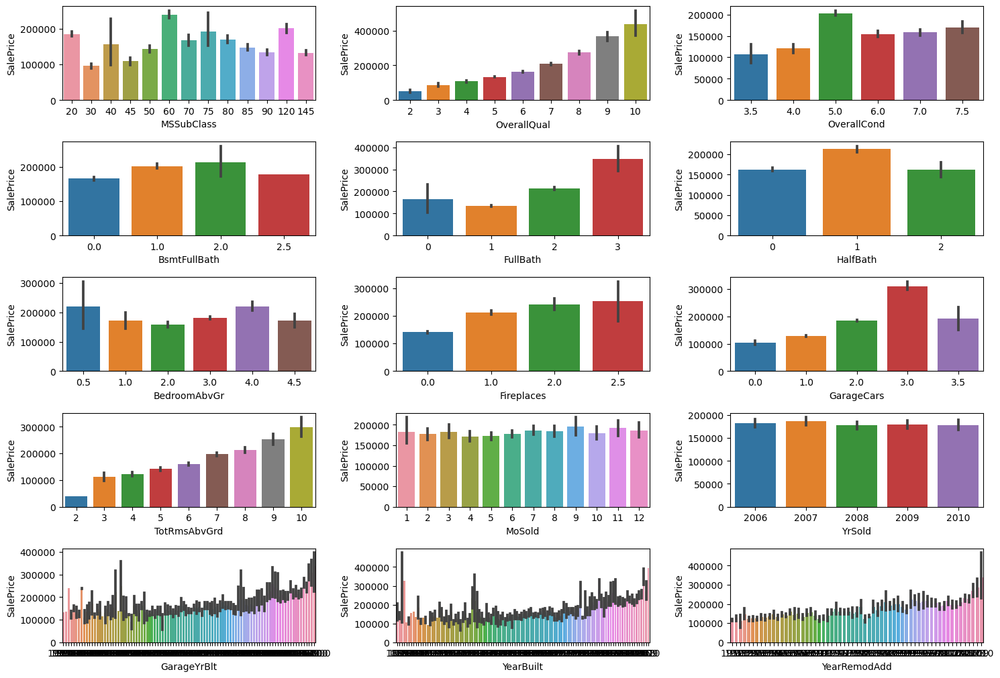

In [23]:
fig = plt.subplots(figsize = (15, 30))
for i, feature in enumerate(['MSSubClass', 'OverallQual', 'OverallCond', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 
                             'Fireplaces', 'GarageCars', 'TotRmsAbvGrd', 'MoSold', 'YrSold', 'GarageYrBlt', 'YearBuilt', 'YearRemodAdd']):
    plt.subplot(15, 3, i+1)
    plt.subplots_adjust(hspace = 2.0)
    sns.barplot(x = housing_2[feature], y = housing_2['SalePrice'])
    plt.tight_layout()

***Comments:***
- MSSubClass: Identifies the type of dwelling involved in the sale. The number denotes the type of house going on sale. SalePrice is highest at 60.
- OverallQual: Rates the overall material and finish of the house. The price increases as the rating increases.
- OverallCond: Rates the overall condition of the house. SalePrice is highest at 5.
- BsmtFullBath: Basement full bathrooms. SalePrice is highest with houses with 2 basement full baths.
- FullBath: Full bathrooms above grade. SalePrice is highest for houses with 3 bathrooms above ground.
- HalfBath: Half baths above grade. SalePrice is highest for houses with 1 half bathroom above ground.
- BedroomAbvGrd: Bedrooms above grade. SalePrice is highest for houses with 4 bedrooms above ground.
- Fireplaces: Number of fireplaces. SalePrice goes up with the number of fire places.
- GarageCars: Size of garage in car capacity. Highest SalePrice is for Garage with a capacity of 3 cars.
- TotRmsAbvGrd: Total rooms above grade. SalePrice increases as the number of rooms above ground increases.
- MoSold: Month Sold (MM). Does not show any patterns with SalePrice.
- YrSold: Year Sold (YYYY). Does not show any patterns with SalePrice.
- YearBuilt: Original construction date. SalePrice is higher as for newer houses.
- YearRemodAdd: Remodel date. SalePrice is higher as for houses remodelled in recent years.
- GarageYrBlt: Year garage was built. SalePrice is higher as for newer garages.

In [24]:
# converting the year related features into number of years

for feature in ['GarageYrBlt', 'YearBuilt', 'YearRemodAdd', 'YrSold']:
    housing_3[feature] = 2023 - housing_3[feature]

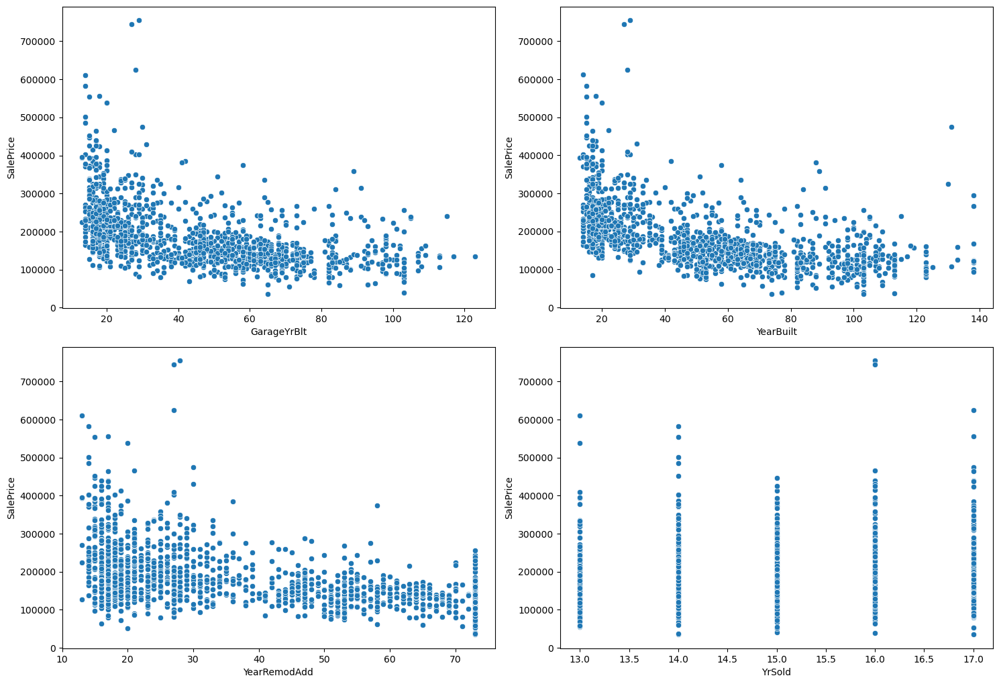

In [25]:
fig = plt.subplots(figsize = (15, 20))
for i, feature in enumerate(['GarageYrBlt', 'YearBuilt', 'YearRemodAdd', 'YrSold']):
    plt.subplot(4, 2, i+1)
    plt.subplots_adjust(hspace = 2.0)
    sns.scatterplot(x = housing_3[feature], y = housing_3['SalePrice'])
    plt.tight_layout()

***Comments:***
- From the plot we can see that the Sale Price is more for recently built garages.
- Sale Price is more for recently built houses.
- Houses which have been recently remodelled have higher prices.
- YrSold does not show any trend for SalePrice.

In [26]:
# Dropping YrSold


housing_3 = housing_3.drop(labels = 'YrSold', axis = 1)

#Checking the shape of the dataset

print(f'The dataset contains {housing_3.shape[0]} rows and {housing_3.shape[1]} columns')

The dataset contains 1460 rows and 66 columns


In [27]:
# Checking for missing values

for feature in housing_3.select_dtypes(exclude = ['object']).columns:
    if housing_3[feature].isnull().any():
        print(feature, ' : ', round(housing_3[feature].isnull().sum()/housing_3.shape[0], 2)*100,'%')

LotFrontage  :  18.0 %
MasVnrArea  :  1.0 %
GarageYrBlt  :  6.0 %


**Dropping variables with high correlation between themselves.** <br>
**From the heatmap we know that:**
- GarageCars and GarageArea (correlation coefficient = 0.88). Dropping GarageCars.
- GarageYrBlt and YearBuilt (correlation coefficient = 0.83). Dropping GarageYrBlt since it contains missing values.
- TotRmsAbvGrd and GrLivArea (correlation coefficient = 0.83). Dropping GrLivArea.
- TotalBsmtSF and 1stFlrSF (correlation coefficient = 0.83). Dropping TotalBsmtSF.

In [28]:
# Dropping columns with high correlation

housing_4 = housing_3.drop(labels = ['GarageCars', 'GarageYrBlt', 'GrLivArea', 'TotalBsmtSF'], axis = 1)

#Checking the shape of the dataset

print(f'The dataset contains {housing_4.shape[0]} rows and {housing_4.shape[1]} columns')

The dataset contains 1460 rows and 62 columns


**Analyzing Categorical Features in the Dataset**

In [29]:
#list of categorical features
catagorical.columns

Index(['MSZoning', 'Street', 'LotShape', 'LandContour', 'Utilities',
       'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual',
       'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual',
       'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition'],
      dtype='object')

In [30]:
# Checking for missing values

for feature in housing_4.select_dtypes(include = ['object']).columns:
    if housing_4[feature].isnull().any():
        print(feature, ' : ', round(housing_4[feature].isnull().sum()/housing_4.shape[0], 2)*100,'%')

MasVnrType  :  1.0 %
BsmtQual  :  3.0 %
BsmtCond  :  3.0 %
BsmtExposure  :  3.0 %
BsmtFinType1  :  3.0 %
BsmtFinType2  :  3.0 %
Electrical  :  0.0 %
FireplaceQu  :  47.0 %
GarageType  :  6.0 %
GarageFinish  :  6.0 %
GarageQual  :  6.0 %
GarageCond  :  6.0 %


***Comments:***
- For (BsmtQual, BsmtCond, BsmtExposure, BsmtFinType1, BsmtFinType2), we can assume that NaN means 'No Basement'
- For (GarageType, GarageFinish, GarageQual, GarageCond), we can assume that NaN means 'No Garage'
- For FireplaceQu, we can assume there is no 'Fire Place'
- We will keep MasVnrType and Electrical for imputation later.

In [31]:
# imputing missing basement values with 'No Basement'

housing_4[['BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2']] = housing_4[['BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2']].fillna(value = 'No_Bsmt', axis = 1)

housing_4[['BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2']].isnull().sum()

BsmtQual        0
BsmtCond        0
BsmtExposure    0
BsmtFinType1    0
BsmtFinType2    0
dtype: int64

In [32]:
# imputing missing garage values with 'No Garage'

housing_4[['GarageType', 'GarageFinish', 'GarageQual', 'GarageCond']] = housing_4[['GarageType', 'GarageFinish', 'GarageQual', 'GarageCond']].fillna(value = 'No_Garage', axis = 1)

housing_4[['GarageType', 'GarageFinish', 'GarageQual', 'GarageCond']].isnull().sum()

GarageType      0
GarageFinish    0
GarageQual      0
GarageCond      0
dtype: int64

In [33]:
# imputing missing Fireplace values with 'No Fireplace'

housing_4[['FireplaceQu']] = housing_4[['FireplaceQu']].fillna(value = 'No_Fireplace', axis = 1)

housing_4['FireplaceQu'].isnull().sum()

0

In [34]:
# checking count of missing values in MasVnrType

housing_4['MasVnrType'].isnull().sum()

8

Since **MasVnrType** has about 1% missing data we are dropping the rows with NA since there would not be much loss of information.

In [35]:
# Dropping rows with null values in MasVnrType

housing_4.dropna(subset = ['MasVnrType'], inplace = True)

In [36]:
# checking count of missing values in Electrical

housing_4['Electrical'].isnull().sum()

1

Since **Electrical** has missing values of below 1% we are dropping these rows since this would not result in loss of much information.

In [37]:
# Dropping rows with null values in Electrical

housing_4.dropna(subset = ['Electrical'], inplace = True)

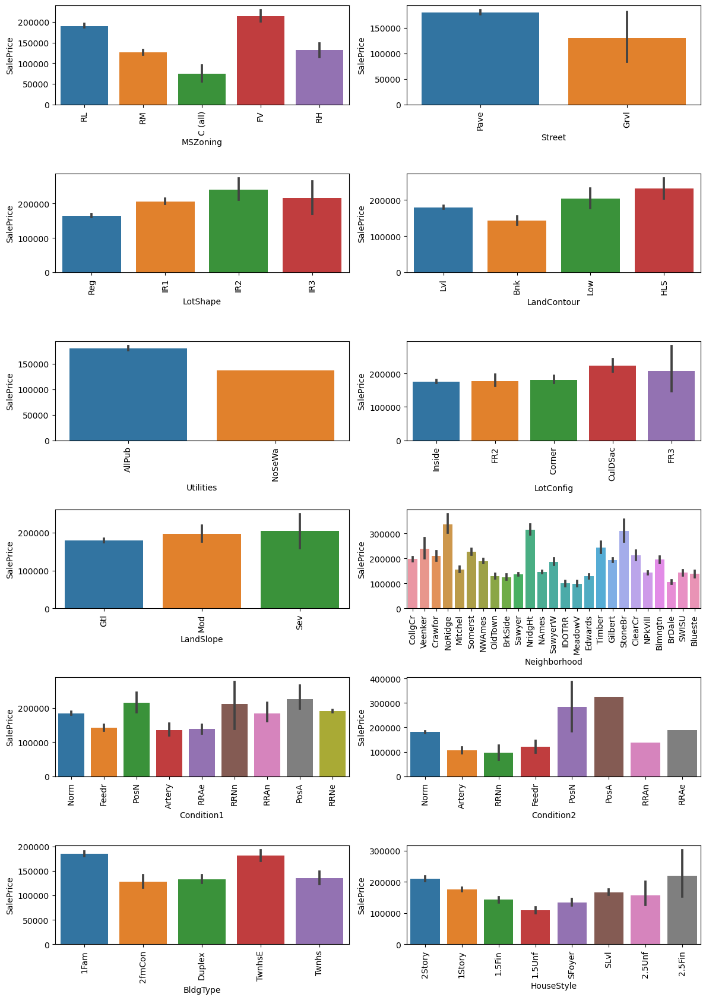

In [38]:
fig = plt.subplots(figsize = (12, 50))
for i, feature in enumerate(catagorical.columns[0:12]):
    plt.subplot(18, 2, i+1)
    plt.subplots_adjust(hspace = 2.0)
    sns.barplot(x = housing_4[feature], y = housing_4['SalePrice'])
    plt.xticks(rotation = 90)
    plt.tight_layout()

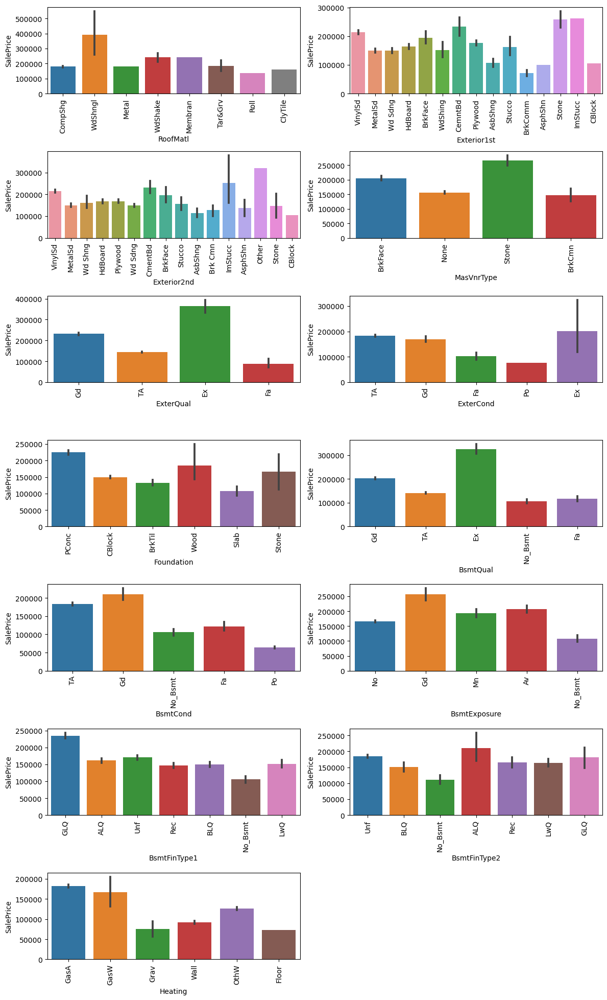

In [39]:
fig = plt.subplots(figsize = (12, 50))
for i, feature in enumerate(catagorical.columns[13:26]):
    plt.subplot(18, 2, i+1)
    plt.subplots_adjust(hspace = 2.0)
    sns.barplot(x = housing_4[feature], y = housing_4['SalePrice'])
    plt.xticks(rotation = 90)
    plt.tight_layout()

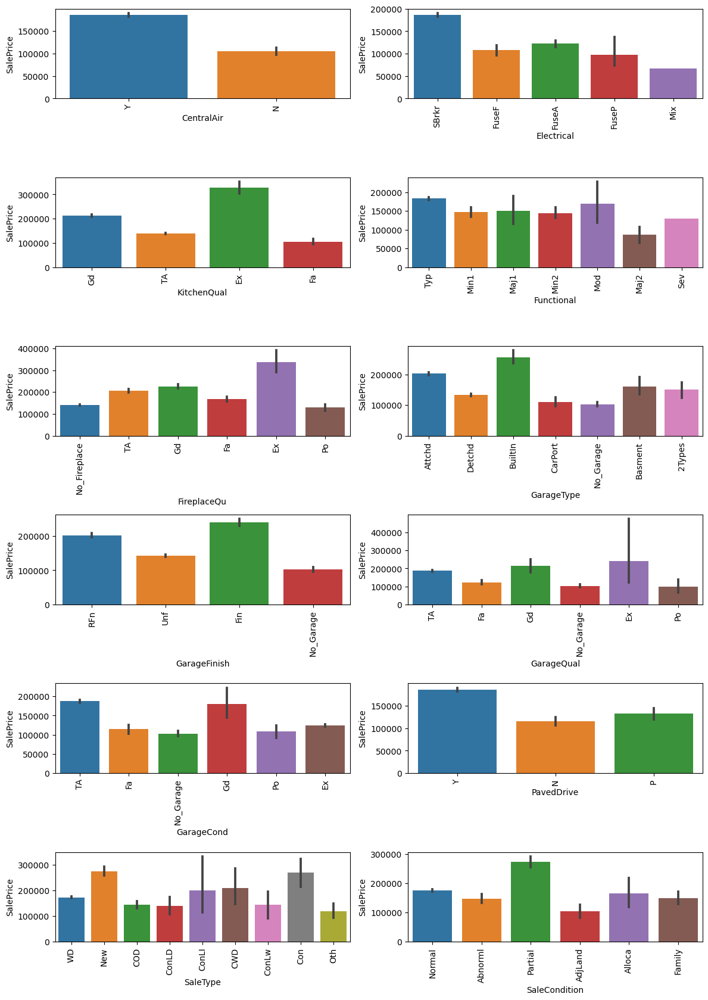

In [40]:
fig = plt.subplots(figsize = (12, 50))
for i, feature in enumerate(catagorical.columns[27:39]):
    plt.subplot(18, 2, i+1)
    plt.subplots_adjust(hspace = 2.0)
    sns.barplot(x = housing_4[feature], y = housing_4['SalePrice'])
    plt.xticks(rotation = 90)
    plt.tight_layout()

In [41]:
# creating dummy variables

dummy_var = pd.get_dummies(data = housing_4[catagorical.columns], drop_first = True) 
dummy_var.head(5)

,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_No_Bsmt,BsmtQual_TA,BsmtCond_Gd,BsmtCond_No_Bsmt,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_No_Bsmt,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_No_Bsmt,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_No_Bsmt,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_No_Fireplace,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_No_Garage,GarageFinish_No_Garage,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_No_Garage,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_No_Garage,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0
1,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0

In [42]:
#Checking the shape of the dummy variables dataset

print(f'The dummy dataset contains {dummy_var.shape[0]} rows and {dummy_var.shape[1]} columns')

The dummy dataset contains 1451 rows and 210 columns


In [43]:
# Dropping Categorical freatures from the dataset

housing_5 = housing_4.drop(labels = catagorical.columns, axis = 1)
print(f'The dataset contains {housing_5.shape[0]} rows and {housing_5.shape[1]} columns')

The dataset contains 1451 rows and 23 columns


In [44]:
# Adding dummies into the data set

housing_6 = pd.concat([housing_5, dummy_var], axis = 1)
print(f'The dataset contains {housing_6.shape[0]} rows and {housing_6.shape[1]} columns')

The dataset contains 1451 rows and 233 columns


**Checking the Distribution of Sale Price**

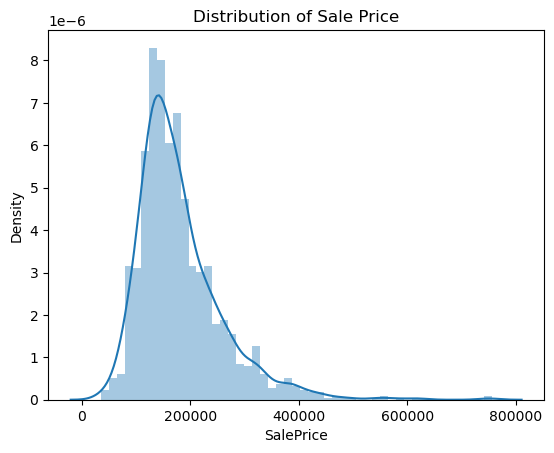

In [45]:
# Checking the distribution of Sale Price which is the target variable

plt.title('Distribution of Sale Price')
sns.distplot(housing_6['SalePrice'])
plt.show()

***Comments:***
- From the plot we can see that the data is highly right skewed.
- We need to transform the data to make it normally distributed.

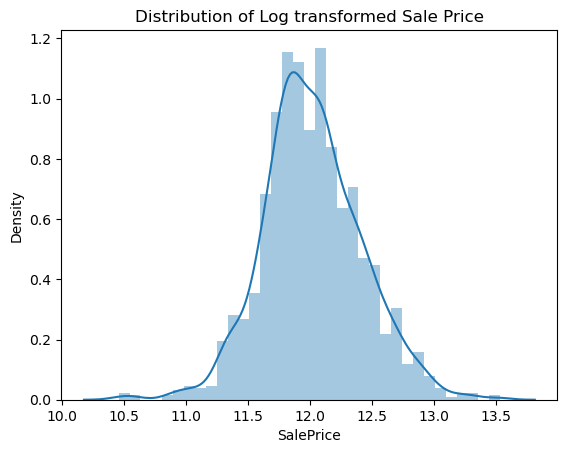

In [46]:
# Transforming Sale Price and checking its distribution

plt.title('Distribution of Log transformed Sale Price')
sns.distplot(np.log(housing_6['SalePrice']))
plt.show()

***Comment:*** <br>
Doing a log transformation on SalePrice brings it closer to a normal distribution.

### Splitting Data into Training and Test sets
- We will be splitting the dataset into the Train Set and the Test Set. 
- We will use the train set to train the regression model so that it can learn the coefficients.
- We will use the coefficients leanred from the train set and apply them into the test set and see how well the model explains the variation.

In [47]:
x = housing_6.drop(['SalePrice'], axis = 1)

print(f'The x dataset contains {x.shape[0]} rows and {x.shape[1]} columns')

The x dataset contains 1451 rows and 232 columns


In [48]:
# Using Log Transformation on Sale Price

y = np.log(housing_6['SalePrice'])
print(y.describe())

count    1451.000000
mean       12.022388
std         0.399502
min        10.460242
25%        11.774520
50%        11.998433
75%        12.273731
max        13.534473
Name: SalePrice, dtype: float64


In [49]:
# importing train_test_split
from sklearn.model_selection import train_test_split

In [50]:
# Splitting the data

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 100)

In [51]:
print(f'The x_train dataset contains {x_train.shape[0]} rows and {x_train.shape[1]} columns')
print(f'The x_test dataset contains {x_test.shape[0]} rows and {x_test.shape[1]} columns')
print(f'y_train Set shape: {y_train.shape}')
print(f'y_test Set shape: {y_test.shape}')

The x_train dataset contains 1160 rows and 232 columns
The x_test dataset contains 291 rows and 232 columns
y_train Set shape: (1160,)
y_test Set shape: (291,)


**Imputing Missing Values** <br>
We know the 'LotFrontage' had the 18% missing values. Since dropping these rows would have resulted in loss of data we are going use mean to replace the missing values.

In [52]:
# importing SimpleImputer
from sklearn.impute import SimpleImputer

In [53]:
# Imputing missing values of LotFrontage after splitting training and test set to prevent data leakage

si = SimpleImputer(missing_values = np.nan, strategy = 'mean')
si.fit(x_train[['LotFrontage']])

SimpleImputer()

In [54]:
x_train[['LotFrontage']] = si.transform(x_train[['LotFrontage']]) 

In [55]:
x_test[['LotFrontage']] = si.transform(x_test[['LotFrontage']]) 

In [56]:
x_train['LotFrontage'].isnull().sum()

0

In [57]:
x_test['LotFrontage'].isnull().sum()

0

### Feature Scaling

- We are going to rescale the data for a more accurate prediction. <br>
- We will be using the StandardScaler to standardize the data.

In [58]:
# Importing MinMaxScaler
from sklearn.preprocessing import StandardScaler

In [59]:
ss = StandardScaler()
ss.fit(x_train)

StandardScaler()

In [60]:
sca_var = ['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtUnfSF', '1stFlrSF', '2ndFlrSF', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF']

x_train[sca_var]

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtUnfSF,1stFlrSF,2ndFlrSF,GarageArea,WoodDeckSF,OpenPorchSF
624,80.00000,10400.0,288.0,247.000,485.0,1012.000,778,484.00,148,0
592,60.00000,6600.0,0.0,816.000,0.0,816.000,0,816.00,0,0
48,33.00000,4456.0,0.0,0.000,736.0,736.000,716,0.00,0,0
1070,72.00000,10152.0,120.0,586.000,462.0,1048.000,0,286.00,0,20
1234,55.00000,8525.0,0.0,0.000,940.0,1024.000,940,0.00,0,170
1366,68.00000,9179.0,158.0,633.000,240.0,882.000,908,588.00,0,88
590,64.00000,8320.0,0.0,490.000,280.0,770.000,812,520.00,0,45
110,75.00000,9525.0,0.0,444.000,550.0,1216.000,639,325.00,182,0
198,92.00000,5520.0,0.0,0.000,755.0,929.000,929,0.00,0,170
67,72.00000,10665.0,167.0,1013.000,440.0,1479.000,0,558.00,144,29


In [61]:
# Scaling the continuous numerical data

x_train_scl = pd.DataFrame(data = ss.transform(x_train), columns = x_train.columns)
x_test_scl = pd.DataFrame(data = ss.transform(x_test), columns = x_train.columns)

In [62]:
x_train_scl

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,1stFlrSF,2ndFlrSF,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,TotRmsAbvGrd,Fireplaces,GarageArea,WoodDeckSF,OpenPorchSF,MoSold,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_No_Bsmt,BsmtQual_TA,BsmtCond_Gd,BsmtCond_No_Bsmt,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_No_Bsmt,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_No_Bsmt,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_No_Bsmt,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_No_Fireplace,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_No_Garage,GarageFinish_No_Garage,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_No_Garage,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_No_Garage,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,0.116468,0.615582,0.215020,-0.087362,-0.578407,-0.018896,0.637763,1.468321,-0.436795,-0.202574,-0.392775,0.981912,1.111366,-1.036937,3.254593,1.539771,0.986233,0.613473,0.060117,0.507505,-0.811550,1.739807,-0.205495,

In [63]:
x_test_scl.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtUnfSF,1stFlrSF,2ndFlrSF,BsmtFullBath,FullBath,HalfBath,BedroomAbvGr,TotRmsAbvGrd,Fireplaces,GarageArea,WoodDeckSF,OpenPorchSF,MoSold,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_No_Bsmt,BsmtQual_TA,BsmtCond_Gd,BsmtCond_No_Bsmt,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_No_Bsmt,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_No_Bsmt,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_No_Bsmt,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_No_Fireplace,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_No_Garage,GarageFinish_No_Garage,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_No_Garage,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_No_Garage,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,1.710598,-1.407032,-1.507949,-0.816429,-0.578407,-0.152345,0.441593,-0.673489,1.011076,-0.702617,-0.036624,-0.799184,1.111366,-1.036937,1.245371,0.208325,-0.297752,0.613473,0.270335,2.881880,0.877864,0.630919,-0.2054

### Feature Scaling with RFE

In [64]:
# Importing RFE and LinearRegression
from sklearn.feature_selection import RFE

In [65]:
# Creating a function to return the top n features given by RFE

def top_n_features(n):
    top_n_cols = []
    
    lm = LinearRegression()
    lm.fit(x_train_scl, y_train)
    rfe = RFE(estimator = LinearRegression(), n_features_to_select = n)
    rfe = rfe.fit(x_train_scl, y_train)
    
    print("Top %d features:" %n)
    rfe_ranking = list(zip(x_train_scl.columns, rfe.support_, rfe.ranking_))
    
    for i in rfe_ranking:
        if i[1]:
            top_n_cols.append(i[0])
    print(top_n_cols)
    return top_n_cols

In [110]:
# checking top 45, 50 and 55 features
top_45 = top_n_features(15)
#top_50 = top_n_features(50)
#top_55 = top_n_features(55)

Top 15 features:
['LotArea', 'OverallQual', 'OverallCond', 'YearBuilt', 'BsmtFinSF1', '1stFlrSF', '2ndFlrSF', 'RoofMatl_CompShg', 'RoofMatl_Membran', 'RoofMatl_Metal', 'RoofMatl_Tar&Grv', 'RoofMatl_WdShake', 'RoofMatl_WdShngl', 'SaleType_New', 'SaleCondition_Partial']


In [67]:
# importing statsmodel
import statsmodels.api as sm

In [68]:
# Given the training and the list of features, this will provide the statiscal summary of the model
# this will be used to check the adjusted R-squared of the top 45, 50 and 55 features

def build_regression(x_train, y_train, cols):
    x_train_ols = sm.add_constant(x_train[cols])
    lr = sm.OLS(y_train.values.reshape(-1, 1), x_train_ols).fit()
    print(lr.summary())

In [69]:
#building regression with top 45 features
build_regression(x_train_scl, y_train, top_45)

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.926
Model:                            OLS   Adj. R-squared:                  0.923
Method:                 Least Squares   F-statistic:                     316.8
Date:                Wed, 30 Aug 2023   Prob (F-statistic):               0.00
Time:                        19:44:37   Log-Likelihood:                 927.95
No. Observations:                1160   AIC:                            -1766.
Df Residuals:                    1115   BIC:                            -1538.
Df Model:                          44                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    12.02

In [70]:
#building regression with top 50 features
build_regression(x_train_scl, y_train, top_50)

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.926
Model:                            OLS   Adj. R-squared:                  0.923
Method:                 Least Squares   F-statistic:                     303.0
Date:                Wed, 30 Aug 2023   Prob (F-statistic):               0.00
Time:                        19:44:37   Log-Likelihood:                 928.71
No. Observations:                1160   AIC:                            -1763.
Df Residuals:                    1113   BIC:                            -1526.
Df Model:                          46                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     12

In [71]:
#building regression with top 55 features
build_regression(x_train_scl, y_train, top_55)

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.926
Model:                            OLS   Adj. R-squared:                  0.923
Method:                 Least Squares   F-statistic:                     296.4
Date:                Wed, 30 Aug 2023   Prob (F-statistic):               0.00
Time:                        19:44:37   Log-Likelihood:                 929.02
No. Observations:                1160   AIC:                            -1762.
Df Residuals:                    1112   BIC:                            -1519.
Df Model:                          47                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     12

**Comment:** <br>
By inspecting the R-Square and Adjusted R-Square vaules of the top 45, 50 and 55 features we observe that both R-Squred and Adjusted R-Squre values are same for 45, 50 and 55. Therefore we consider 45 to be the optimum number of features to be considered.

In [72]:
x_train_rfe = x_train_scl[top_45]
x_test_rfe = x_test_scl[top_45]

In [73]:
# Reusable code for Cross-Validation, Model Building and Model Evaluation

def build_model(x_train, y_train, x_test, y_test, params, model = 'ridge'):
    if model == 'ridge':
        estimator_model = Ridge()
    else:
        estimator_model = Lasso()
    model_cv = GridSearchCV(estimator = estimator_model,
                           param_grid = params,
                           scoring = 'neg_mean_absolute_error',
                           cv = 5,
                           return_train_score = True,
                           verbose = 1)
    model_cv.fit(x_train, y_train)
    alpha = model_cv.best_params_["alpha"]
    print("Optimum alpha for %s is %f" %(model,alpha))
    final_model = model_cv.best_estimator_
    
    final_model.fit(x_train, y_train)
    y_train_pred = final_model.predict(x_train)
    y_test_pred = final_model.predict(x_test)
    
    # Model Evaluation
    print(model, " Regression with ", alpha)
    print("========================================")
    print('R2 Score (train) : ', r2_score(y_train, y_train_pred))
    print('R2 Score (test) : ', r2_score(y_test, y_test_pred))
    print('RMSE (train) : ', np.sqrt(mean_squared_error(y_train, y_train_pred)))
    print('RMSE (train) : ', np.sqrt(mean_squared_error(y_test, y_test_pred)))
    
    return final_model, y_test_pred

## Ridge Regression

In [74]:
params = {'alpha': [0.0001, 0.001, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0,
                   10.0, 20, 50, 100, 500, 1000]}

ridge_final_model, y_test_predicted = build_model(x_train_rfe, y_train, x_test_rfe, y_test, params, model = 'ridge')

Fitting 5 folds for each of 26 candidates, totalling 130 fits
Optimum alpha for ridge is 50.000000
ridge  Regression with  50
R2 Score (train) :  0.9174162656466028
R2 Score (test) :  0.8878676285719543
RMSE (train) :  0.11481863707452225
RMSE (train) :  0.13344171276419464


***Comments:***
- Ridge Regression model has achieved a R2-score of 0.887 on the test data, i.e., 88.7% of the variation in the test data can be explained by the model.
- Root Mean Squared Error = 0.1334 on the test data meaning the prediction made by the model could be off by 0.1334 unit.

## Lasso Regression

In [75]:
params = {'alpha': [0.0001, 0.001, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0,
                   10.0, 20, 50, 100, 500, 1000]}

lasso_final_model, y_test_predicted = build_model(x_train_rfe, y_train, x_test_rfe, y_test, params, model = 'lasso')

Fitting 5 folds for each of 26 candidates, totalling 130 fits
Optimum alpha for lasso is 0.001000
lasso  Regression with  0.001
R2 Score (train) :  0.9220287606082328
R2 Score (test) :  0.890957118006536
RMSE (train) :  0.11156612459354591
RMSE (train) :  0.1315905690055296


***Comments:***
- Lasso Regression model has achieved a R2-score of 0.890 on the test data, i.e., 89.0% of the variation in the test data can be explained by the model.
- Root Mean Squared Error = 0.1315 on the test data meaning the prediction made by the model could be off by 0.1315 unit.

**Comparing Model Coefficients**

In [76]:
model_coefficients = pd.DataFrame(index = x_test_rfe.columns)
model_coefficients.rows = x_test_rfe.columns

model_coefficients['Ridge (alpha = 50)'] = ridge_final_model.coef_
model_coefficients['Lasso (alpha = 0.001)'] = lasso_final_model.coef_
pd.set_option('display.max_rows', None)
model_coefficients

,Ridge (alpha = 50),Lasso (alpha = 0.001)
LotArea,0.039209,0.037038
OverallQual,0.094218,0.095965
OverallCond,0.046147,0.049327
YearBuilt,-0.053711,-0.060518
YearRemodAdd,-0.024570,-0.021121
BsmtFinSF1,0.042815,0.043148
1stFlrSF,0.120060,0.131712
2ndFlrSF,0.105466,0.114695
BsmtFullBath,0.013581,0.013897
GarageArea,0.037156,0.033807


## Final Model <br>
Lasso Regression produced slightly better R2-Score on the test data than Ridge Regression. Therefore we are choosing Lasso as the final model.

In [118]:
# top 5 features ordered feature importance in Lasso Regression

model_coefficients[['Lasso (alpha = 0.001)']].sort_values(by = 'Lasso (alpha = 0.001)', ascending = False).head(5)

,Lasso (alpha = 0.001)
1stFlrSF,0.131712
RoofMatl_CompShg,0.118641
2ndFlrSF,0.114695
OverallQual,0.095965
RoofMatl_Tar&Grv,0.080881


***Inference:*** <br>
5 most important numeical predictor variables are:

- 1stFlrSF : First Floor square feet, has a positive relationship with price so increase in area would mean increase in price.
- RoofMatl_CompShg : Roof Material - Standard (Composite) Shingle, has a positive relationship with price and has standard demand.
- 2ndFlrSF: 2nd Floor square feet, has a positive relationship with price so increase in area would mean increase in price.
- OverallQual : Rates the overall material and finish of the house, has a positive relationship with price so a high rating would mean increase in price.
- RoofMatl_Tar&Grv : Roof Material - Gravel & Tar, has a positive relationship with price and has standard demand.

Higher positive value of the coefficients suggests high value in sale.

**Answer for Question 1**

In [79]:
params = {'alpha': [50*2]}

ridge_final_model, y_test_predicted = build_model(x_train_rfe, y_train, x_test_rfe, y_test, params, model = 'ridge')

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Optimum alpha for ridge is 100.000000
ridge  Regression with  100
R2 Score (train) :  0.9123417904623115
R2 Score (test) :  0.8858273861032065
RMSE (train) :  0.11829364842992007
RMSE (train) :  0.13465022274529348


In [80]:
params = {'alpha': [0.001*2]}

lasso_final_model, y_test_predicted = build_model(x_train_rfe, y_train, x_test_rfe, y_test, params, model = 'lasso')

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Optimum alpha for lasso is 0.002000
lasso  Regression with  0.002
R2 Score (train) :  0.9137299442532767
R2 Score (test) :  0.8884981934990942
RMSE (train) :  0.11735326257111758
RMSE (train) :  0.13306598588927357


In [81]:
model_coefficients_2 = pd.DataFrame(index = x_test_rfe.columns)
model_coefficients_2.rows = x_test_rfe.columns

model_coefficients_2['Ridge (alpha = 100)'] = ridge_final_model.coef_
model_coefficients_2['Lasso (alpha = 0.002)'] = lasso_final_model.coef_
pd.set_option('display.max_rows', None)
model_coefficients_2

,Ridge (alpha = 100),Lasso (alpha = 0.002)
LotArea,0.040081,0.035995
OverallQual,0.094190,0.101138
OverallCond,0.042588,0.049048
YearBuilt,-0.047403,-0.059561
YearRemodAdd,-0.026707,-0.020927
BsmtFinSF1,0.042810,0.042643
1stFlrSF,0.110099,0.129532
2ndFlrSF,0.097327,0.111605
BsmtFullBath,0.012733,0.012209
GarageArea,0.041084,0.035639


In [82]:
model_coefficients_2[['Ridge (alpha = 100)']].sort_values(by = 'Ridge (alpha = 100)', ascending = False).index[:1]

Index(['1stFlrSF'], dtype='object')

In [83]:
model_coefficients_2[['Lasso (alpha = 0.002)']].sort_values(by = 'Lasso (alpha = 0.002)', ascending = False).index[:1]

Index(['1stFlrSF'], dtype='object')

**Answer for Question 3**

In [111]:
# dropping top 5 predictors

x_train_rfe_2 = x_train_rfe.drop(labels = ['1stFlrSF', 'RoofMatl_CompShg', '2ndFlrSF', 'OverallQual', 'RoofMatl_Tar&Grv'], axis = 1)
x_test_rfe_2 = x_test_rfe.drop(labels = ['1stFlrSF', 'RoofMatl_CompShg', '2ndFlrSF', 'OverallQual', 'RoofMatl_Tar&Grv'], axis = 1)

In [112]:
print(x_train_rfe_2.shape)
print(x_test_rfe_2.shape)
print(y_train.shape)
print(y_test.shape)

(1160, 40)
(291, 40)
(1160,)
(291,)


In [113]:
# running lasso regression

params = {'alpha': [0.001]}

lasso_final_model, y_test_predicted = build_model(x_train_rfe_2, y_train, x_test_rfe_2, y_test, params, model = 'lasso')

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Optimum alpha for lasso is 0.001000
lasso  Regression with  0.001
R2 Score (train) :  0.802195707130242
R2 Score (test) :  0.7624392548681158
RMSE (train) :  0.17769818217098007
RMSE (train) :  0.19422871797707045


In [114]:
model_coefficients_3 = pd.DataFrame(index = x_test_rfe_2.columns)
model_coefficients_3.rows = x_test_rfe_2.columns

model_coefficients_3['Lasso (alpha = 0.001)'] = lasso_final_model.coef_
pd.set_option('display.max_rows', None)

In [116]:
model_coefficients_3[['Lasso (alpha = 0.001)']].sort_values(by = 'Lasso (alpha = 0.001)', ascending = False).index[:5]

Index(['MSZoning_RL', 'MSZoning_RM', 'MSZoning_FV', 'GarageArea', 'LotArea'], dtype='object')